📂 Loading the New Jersey Property Dataset Overview This script loads a CSV file containing commerical New Jersey property data into a Pandas DataFrame for further analysis.

 1. Load the CSV File import pandas as pd
        Load the CSV file with low_memory=False
        file_path = "../data/commericalnj.csv" df2 = pd.read_csv(file_path, low_memory=False)

In [1]:
import pandas as pd

# Load the CSV file with low_memory=False
file_path = "../data/commericalnj.csv"
df2 = pd.read_csv(file_path, low_memory=False)

# Display the first few rows
df2.head()

# Print the available columns in the DataFrame
print("\nAvailable columns in the DataFrame:")
print(df2.columns)


Available columns in the DataFrame:
Index(['Municipality', 'Block', 'Lot', 'Qual', 'Property Location',
       'Property Class', 'Owner's Name', 'Owner's Mailing Address',
       'City/State/Zip', 'Sq. Ft.', 'Yr. Built', 'Building Class',
       'Prior Block', 'Prior Lot', 'Prior Qual', 'Updated', 'Zone', 'Account',
       'Mortgage Account', 'Bank Code', 'Sp Tax Cd', 'Sp Tax Cd.1',
       'Sp Tax Cd.2', 'Sp Tax Cd.3', 'Map Page', 'Additional Lots',
       'Land Desc', 'Building Desc', 'Class 4 Code', 'Acreage', 'EPL Own',
       'EPL Use', 'EPL Desc', 'EPL Statute', 'EPL Init', 'EPL Further',
       'EPL Facility Name', 'Taxes 1', 'Taxes 2', 'Taxes 3', 'Taxes 4',
       'Sale Date', 'Deed Book', 'Deed Page', 'Sale Price', 'NU Code', 'Ratio',
       'Type/Use', 'Year', 'Owner', 'Street', 'City/State/Zip.1',
       'Land Assmnt', 'Building Assmnt', 'Exempt', 'Total Assmnt', 'Assessed',
       'Year.1', 'Owner.1', 'Street.1', 'City/State/Zip.2', 'Land Assmnt.1',
       'Building Assmnt.

import pandas as pd
import numpy as np

# ============================
# Step 0: Load Your Data
# ============================
# Replace the file_path with the correct path to your CSV file
file_path = "../data/commericalnj.csv"
df2 = pd.read_csv(file_path, low_memory=False)

print("---- First 5 rows of df2 ----")
print(df2.head())

# ============================
# Step 1: Convert and Prepare Date and Numeric Columns
# ============================
# Convert 'Sale Date' to datetime
df2['Sale Date'] = pd.to_datetime(df2['Sale Date'], errors='coerce')
print("\n---- 'Sale Date' sample values ----")
print(df2[['Sale Date']].head())

# Convert 'Sale Price' to numeric and filter out non-positive values
df2['Sale Price'] = pd.to_numeric(df2['Sale Price'], errors='coerce')
df2 = df2[df2['Sale Price'] > 0]
print("\n---- 'Sale Price' statistics ----")
print(df2['Sale Price'].describe())

# Convert 'Total Assmnt' to numeric (for debugging Total Assessed Value)
df2['Total Assmnt'] = pd.to_numeric(df2['Total Assmnt'], errors='coerce')
print("\n---- 'Total Assmnt' statistics ----")
print(df2['Total Assmnt'].describe())

# ============================
# Step 2: Create a Unique Property Identifier and Sort
# ============================
# Create a unique property identifier; adjust columns as needed
df2['PropertyID'] = df2['Block'].astype(str) + "_" + df2['Lot'].astype(str) + "_" + df2['Qual'].astype(str)

# Sort by PropertyID and Sale Date to get the correct chronological order per property
df2 = df2.sort_values(by=['PropertyID', 'Sale Date'])

# ============================
# Step 3: Derive Seller and Buyer Names
# ============================
# For each property, the seller is the previous record's owner and the buyer is the current owner.
df2["Seller Name"] = df2.groupby("PropertyID")["Owner's Name"].shift(1)
df2["Buyer Name"] = df2["Owner's Name"]
df2["Seller Name"] = df2["Seller Name"].fillna("Initial Sale")

print("\n---- Sample rows with Buyer and Seller Names ----")
print(df2[['PropertyID', 'Sale Date', "Owner's Name", 'Seller Name', 'Buyer Name']].head(20))

# To further debug, choose a property with multiple sales and print all its records:
property_example = df2['PropertyID'].value_counts().idxmax()
print("\n---- Sales for PropertyID (with most sales):", property_example, "----")
print(df2[df2['PropertyID'] == property_example][["Sale Date", "Owner's Name", "Seller Name", "Buyer Name"]])

# ============================
# Step 4: Debug Total Assessed Value
# ============================
# Print the first 10 rows of Total Assessed Value to inspect the values
print("\n---- First 10 rows of 'Total Assmnt' ----")
print(df2[['Total Assmnt']].head(10))

# If the assessed values seem too high relative to the sale price, they might be in thousands.
# For example, if the mean of 'Total Assmnt' is much higher than 'Sale Price', consider:
# df2['Total Assmnt (dollars)'] = df2['Total Assmnt'] * 1000

# ============================
# Step 5: (Optional) Save Debug Data for Further Inspection
# ============================
# df2.to_csv("debug_output.csv", index=False)


In [2]:
import pandas as pd
import numpy as np

# ============================
# Step 0: Load Your Data
# ============================
# Replace the file_path with the correct path to your CSV file
file_path = "../data/commericalnj.csv"
df2 = pd.read_csv(file_path, low_memory=False)

print("---- First 5 rows of df2 ----")
print(df2.head())

# ============================
# Step 1: Convert and Prepare Date and Numeric Columns
# ============================
# Convert 'Sale Date' to datetime
df2['Sale Date'] = pd.to_datetime(df2['Sale Date'], errors='coerce')
print("\n---- 'Sale Date' sample values ----")
print(df2[['Sale Date']].head())

# Convert 'Sale Price' to numeric and filter out non-positive values
df2['Sale Price'] = pd.to_numeric(df2['Sale Price'], errors='coerce')
df2 = df2[df2['Sale Price'] > 0]
print("\n---- 'Sale Price' statistics ----")
print(df2['Sale Price'].describe())

# Convert 'Total Assmnt' to numeric (for debugging Total Assessed Value)
df2['Total Assmnt'] = pd.to_numeric(df2['Total Assmnt'], errors='coerce')
print("\n---- 'Total Assmnt' statistics ----")
print(df2['Total Assmnt'].describe())

# ============================
# Step 2: Create a Unique Property Identifier and Sort
# ============================
# Create a unique property identifier; adjust columns as needed
df2['PropertyID'] = df2['Block'].astype(str) + "_" + df2['Lot'].astype(str) + "_" + df2['Qual'].astype(str)

# Sort by PropertyID and Sale Date to get the correct chronological order per property
df2 = df2.sort_values(by=['PropertyID', 'Sale Date'])

# ============================
# Step 3: Derive Seller and Buyer Names
# ============================
# For each property, the seller is the previous record's owner and the buyer is the current owner.
df2["Seller Name"] = df2.groupby("PropertyID")["Owner's Name"].shift(1)
df2["Buyer Name"] = df2["Owner's Name"]
df2["Seller Name"] = df2["Seller Name"].fillna("Initial Sale")

print("\n---- Sample rows with Buyer and Seller Names ----")
print(df2[['PropertyID', 'Sale Date', "Owner's Name", 'Seller Name', 'Buyer Name']].head(20))

# To further debug, choose a property with multiple sales and print all its records:
property_example = df2['PropertyID'].value_counts().idxmax()
print("\n---- Sales for PropertyID (with most sales):", property_example, "----")
print(df2[df2['PropertyID'] == property_example][["Sale Date", "Owner's Name", "Seller Name", "Buyer Name"]])

# ============================
# Step 4: Debug Total Assessed Value
# ============================
# Print the first 10 rows of Total Assessed Value to inspect the values
print("\n---- First 10 rows of 'Total Assmnt' ----")
print(df2[['Total Assmnt']].head(10))

# If the assessed values seem too high relative to the sale price, they might be in thousands.
# For example, if the mean of 'Total Assmnt' is much higher than 'Sale Price', consider:
# df2['Total Assmnt (dollars)'] = df2['Total Assmnt'] * 1000

# ============================
# Step 5: (Optional) Save Debug Data for Further Inspection
# ============================
# df2.to_csv("debug_output.csv", index=False)


---- First 5 rows of df2 ----
   Municipality  Block    Lot   Qual      Property Location Property Class  \
0          1301    1.0      2    NaN     39-41 ATLANTIC AVE              1   
1          1301    1.0  15.01    NaN           ATLANTIC AVE            15F   
2          1301    4.0      1    NaN  S/S NY LONG BRANCH RR            15F   
3          1301  155.0      1  C0216         16 MIDLAND AVE            15F   
4          1301   11.0      1    NaN           740 LLOYD RD             4A   

                          Owner's Name Owner's Mailing Address  \
0            39-41 ATLANTIC AVENUE LLC          431 JERSEY AVE   
1  CROSSING @ ABERDEEN %HOMESTEAD MGMT             PO BOX 7499   
2     SANTE FE JUNCTION HOMEOWNERS INC               PO BOX 77   
3                          SI, WILLIAM          16 MIDLAND AVE   
4                 KEYNET ABERDEEN, LLC            740 LLOYD RD   

            City/State/Zip  Sq. Ft.  ...  Total Assmnt.3 Assessed.3  \
0   JERSEY CITY, NJ  07302     11

Real Estate Sales Map Tool Documentation
This document describes an interactive real estate sales map tool built with Python and Folium. The tool displays detailed property information for properties in New Jersey. When a user clicks on a property marker on the map, a popup shows the following information:

Full Address: Combined from the "Property Location" and "City/State/Zip" columns.
Property Class
Seller Name and Seller Address
Buyer Name and Buyer Address
Sale Price
Sale Date
Total Assessed Value (formatted as dollars)
Lot Price per Acre (calculated if acreage is available)
Building Price per Sq. Ft. (calculated if square footage is available)
Property Tax (formatted as dollars)
The tool also applies a custom color scheme to the markers based on the sale price, using a multi-segment normalization and a combined colormap with five segments:

Brown: for sale prices under $500K
Yellow: for sale prices 
1M
Blue: for sale prices 
2.5M
Green: for sale prices 
10M
Red: for sale prices over $10M
Code
Below is the complete code. Make sure your dataset (loaded into df2) contains the necessary columns. Adjust column names as needed.

# Install folium if needed (uncomment if necessary)
!pip install folium

import pandas as pd
import numpy as np
import folium
import matplotlib.colors as mcolors
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.pyplot as plt

# ========================================
# 1. Data Preparation using df2
# ========================================
# Load your CSV file if not already loaded (here we assume df2 is your DataFrame)
# Example:
# df2 = pd.read_csv("../data/commericalnj.csv", low_memory=False)

# Filter to include only New Jersey properties (approximate boundaries)
df_nj = df2[
    (df2['Latitude'] >= 38.5) & (df2['Latitude'] <= 42) &
    (df2['Longitude'] >= -76) & (df2['Longitude'] <= -73)
].copy()

if df_nj.empty:
    raise ValueError("No NJ properties found in the data.")

# Convert 'Sale Price' to numeric and remove non-positive values
df_nj['Sale Price'] = pd.to_numeric(df_nj['Sale Price'], errors='coerce')
df_nj = df_nj[df_nj['Sale Price'] > 0]

# ========================================
# 2. Define Multi-Segment Normalization and Combine Colormaps
# ========================================
class MultiSegmentNorm(mcolors.Normalize):
    """
    Normalize values using an arbitrary number of segments.
    For boundaries [b0, b1, b2, ..., bN], this maps:
      - [b0, b1] to [0, 1/N],
      - [b1, b2] to [1/N, 2/N],
      - ...
      - [b_{N-1}, bN] to [(N-1)/N, 1].
    """
    def __init__(self, boundaries, clip=False):
        super().__init__(clip=clip)
        self.boundaries = np.array(boundaries, dtype=float)
        self.n_segments = len(self.boundaries) - 1

    def __call__(self, value, clip=None):
        v = np.array(value, dtype=float)
        res = np.empty_like(v)
        for i in range(self.n_segments):
            lower = self.boundaries[i]
            upper = self.boundaries[i+1]
            mask = (v >= lower) & (v < upper)
            res[mask] = (i + (v[mask] - lower) / (upper - lower)) / self.n_segments
        res[v >= self.boundaries[-1]] = 1.0
        res[v < self.boundaries[0]] = 0.0
        return res

    def inverse(self, value):
        v = np.array(value, dtype=float)
        res = np.empty_like(v)
        for i in range(self.n_segments):
            lower_norm = i / self.n_segments
            upper_norm = (i+1) / self.n_segments
            mask = (v >= lower_norm) & (v < upper_norm)
            lower = self.boundaries[i]
            upper = self.boundaries[i+1]
            res[mask] = lower + (v[mask] - lower_norm) / (upper_norm - lower_norm) * (upper - lower)
        res[v >= 1.0] = self.boundaries[-1]
        res[v < 0.0] = self.boundaries[0]
        return res

def combine_multiple_colormaps(cmaps, N=256):
    """
    Combine a list of colormaps into one continuous colormap.
    Each colormap contributes approximately 1/len(cmaps) of the total colors.
    """
    n = len(cmaps)
    segments = [int(N/n)] * n
    segments[-1] = N - sum(segments[:-1])
    colors_list = []
    for cmap, seg in zip(cmaps, segments):
        colors_list.append(cmap(np.linspace(0, 1, seg)))
    colors_combined = np.vstack(colors_list)
    return LinearSegmentedColormap.from_list("combined", colors_combined)

# ========================================
# 3. Define Boundaries, Colormaps, and Custom Norm
# ========================================
# Boundaries for sale prices:
#   - b0: 75,000 (minimum)
#   - b1: 500,000   -> up to 500K: brown
#   - b2: 1,000,000 -> 500K to 1M: yellow
#   - b3: 2,500,000 -> 1M to 2.5M: blue
#   - b4: 10,000,000 -> 2.5M to 10M: green
#   - b5: 120,000,000 -> 10M to 120M: red
boundaries = [75000, 500000, 1000000, 2500000, 10000000, 120000000]
custom_norm = MultiSegmentNorm(boundaries)

# Define the five component colormaps:
cmap_brown = LinearSegmentedColormap.from_list("brownshades", ["wheat", "saddlebrown"])
cmap_yellow = LinearSegmentedColormap.from_list("yellowshades", ["lightyellow", "gold"])
cmap_blue = LinearSegmentedColormap.from_list("blueshades", ["lightblue", "blue"])
cmap_green = plt.get_cmap("Greens")
cmap_red = LinearSegmentedColormap.from_list("redshades", ["mistyrose", "darkred"])

combined_cmap = combine_multiple_colormaps([cmap_brown, cmap_yellow, cmap_blue, cmap_green, cmap_red], N=256)

def get_color(sale_price):
    norm_val = custom_norm(sale_price)
    norm_val = norm_val.item() if hasattr(norm_val, "item") else norm_val
    rgba = combined_cmap(norm_val)
    return mcolors.to_hex(rgba)

# ========================================
# 4. Create an Interactive Folium Map with Detailed Popups
# ========================================
# Center the map roughly on New Jersey (latitude ~40, longitude ~-74)
m = folium.Map(location=[40, -74], zoom_start=8)

# Loop through each property and add a marker with extended popup details.
for idx, row in df_nj.iterrows():
    lat = row['Latitude']
    lon = row['Longitude']
    sale_price = row['Sale Price']
    
    # Additional details: adjust these column names as necessary.
    # For a more detailed address, combine "Property Location" and "City/State/Zip"
    property_address = f"{row.get('Property Location', 'N/A')}, {row.get('City/State/Zip', 'N/A')}"
    property_class = row.get('Property Class', 'N/A')
    seller_name = row.get('Seller Name', 'N/A')
    seller_address = row.get("Owner's Mailing Address", 'N/A')
    buyer_name = row.get('Buyer Name', 'N/A')
    buyer_address = f"{row.get('Street', 'N/A')}, {row.get('City/State/Zip.1', 'N/A')}"
    sale_date = row.get('Sale Date', 'N/A')
    
    # Total assessed value: assume it's in dollars; adjust if needed.
    total_assessed = row.get('Total Assmnt', 'N/A')
    if pd.notnull(total_assessed):
        total_assessed = f"${float(total_assessed):,}"
    else:
        total_assessed = "N/A"
    
    acreage = row.get('Acreage', None)
    if acreage and pd.notnull(acreage) and acreage > 0:
        lot_price_per_acre = f"${sale_price/acreage:,.2f}"
    else:
        lot_price_per_acre = "N/A"
    
    sq_ft = row.get('Sq. Ft.', None)
    if sq_ft and pd.notnull(sq_ft) and sq_ft > 0:
        building_price_per_sqft = f"${sale_price/sq_ft:,.2f}"
    else:
        building_price_per_sqft = "N/A"
    
    # Format property tax as dollars.
    property_tax = row.get('Taxes 1', 'N/A')
    if pd.notnull(property_tax):
        property_tax = f"${float(property_tax):,}"
    else:
        property_tax = "N/A"
    
    # Create a multi-line HTML popup string with all the details.
    popup_text = (
        f"<b>Address:</b> {property_address}<br>"
        f"<b>Property Class:</b> {property_class}<br>"
        f"<b>Seller Name:</b> {seller_name}<br>"
        f"<b>Seller Address:</b> {seller_address}<br>"
        f"<b>Buyer Name:</b> {buyer_name}<br>"
        f"<b>Buyer Address:</b> {buyer_address}<br>"
        f"<b>Sale Price:</b> ${int(sale_price):,}<br>"
        f"<b>Sale Date:</b> {sale_date}<br>"
        f"<b>Total Assessed Value:</b> {total_assessed}<br>"
        f"<b>Lot Price per Acre:</b> {lot_price_per_acre}<br>"
        f"<b>Building Price per Sq. Ft.:</b> {building_price_per_sqft}<br>"
        f"<b>Property Tax:</b> {property_tax}"
    )
    
    color_hex = get_color(sale_price)
    folium.CircleMarker(
        location=[lat, lon],
        radius=3,
        color=color_hex,
        fill=True,
        fill_color=color_hex,
        fill_opacity=0.7,
        popup=folium.Popup(popup_text, max_width=300)
    ).add_to(m)

# (Optional) Add a legend using a custom HTML template.
legend_html = '''
<div style="position: fixed; 
     bottom: 50px; left: 50px; width: 250px; height: 170px; 
     border:2px solid grey; z-index:9999; font-size:14px;
     background-color: white;
     ">
     &nbsp;<b>Sale Price Segments</b><br>
     &nbsp;<i>Brown:</i> &nbsp; <span style="background-color: wheat;">&nbsp;&nbsp;&nbsp;&nbsp;</span>&nbsp; < $500K<br>
     &nbsp;<i>Yellow:</i> &nbsp; <span style="background-color: lightyellow;">&nbsp;&nbsp;&nbsp;&nbsp;</span>&nbsp; $500K–$1M<br>
     &nbsp;<i>Blue:</i> &nbsp; <span style="background-color: lightblue;">&nbsp;&nbsp;&nbsp;&nbsp;</span>&nbsp; $1M–$2.5M<br>
     &nbsp;<i>Green:</i> &nbsp; <span style="background-color: #66c2a5;">&nbsp;&nbsp;&nbsp;&nbsp;</span>&nbsp; $2.5M–$10M<br>
     &nbsp;<i>Red:</i> &nbsp; <span style="background-color: mistyrose;">&nbsp;&nbsp;&nbsp;&nbsp;</span>&nbsp; > $10M
</div>
'''
m.get_root().html.add_child(folium.Element(legend_html))

# In a Jupyter Notebook, the last line should be just 'm' to display the interactive map.
m

In [ ]:
# Install folium if needed (uncomment if necessary)
!pip install folium

import pandas as pd
import numpy as np
import folium
import matplotlib.colors as mcolors
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.pyplot as plt

# ========================================
# 1. Data Preparation using df2
# ========================================
# Load your CSV file (if not already loaded, here we assume df2 is your DataFrame)
# For example:
# df2 = pd.read_csv("../data/commericalnj.csv", low_memory=False)

# Filter to include only New Jersey properties (approximate boundaries)
df_nj = df2[
    (df2['Latitude'] >= 38.5) & (df2['Latitude'] <= 42) &
    (df2['Longitude'] >= -76) & (df2['Longitude'] <= -73)
].copy()

if df_nj.empty:
    raise ValueError("No NJ properties found in the data.")

# Convert 'Sale Price' to numeric and remove non-positive values
df_nj['Sale Price'] = pd.to_numeric(df_nj['Sale Price'], errors='coerce')
df_nj = df_nj[df_nj['Sale Price'] > 0]

# ========================================
# 2. Define Multi-Segment Normalization and Combine Colormaps
# ========================================
class MultiSegmentNorm(mcolors.Normalize):
    """
    Normalize values using an arbitrary number of segments.
    For boundaries [b0, b1, b2, ..., bN], this maps:
      - [b0, b1] to [0, 1/N],
      - [b1, b2] to [1/N, 2/N],
      - ...
      - [b_{N-1}, bN] to [(N-1)/N, 1].
    """
    def __init__(self, boundaries, clip=False):
        super().__init__(clip=clip)
        self.boundaries = np.array(boundaries, dtype=float)
        self.n_segments = len(self.boundaries) - 1

    def __call__(self, value, clip=None):
        v = np.array(value, dtype=float)
        res = np.empty_like(v)
        for i in range(self.n_segments):
            lower = self.boundaries[i]
            upper = self.boundaries[i+1]
            mask = (v >= lower) & (v < upper)
            res[mask] = (i + (v[mask] - lower) / (upper - lower)) / self.n_segments
        res[v >= self.boundaries[-1]] = 1.0
        res[v < self.boundaries[0]] = 0.0
        return res

    def inverse(self, value):
        v = np.array(value, dtype=float)
        res = np.empty_like(v)
        for i in range(self.n_segments):
            lower_norm = i / self.n_segments
            upper_norm = (i+1) / self.n_segments
            mask = (v >= lower_norm) & (v < upper_norm)
            lower = self.boundaries[i]
            upper = self.boundaries[i+1]
            res[mask] = lower + (v[mask] - lower_norm) / (upper_norm - lower_norm) * (upper - lower)
        res[v >= 1.0] = self.boundaries[-1]
        res[v < 0.0] = self.boundaries[0]
        return res

def combine_multiple_colormaps(cmaps, N=256):
    """
    Combine a list of colormaps into one continuous colormap.
    Each colormap contributes approximately 1/len(cmaps) of the total colors.
    """
    n = len(cmaps)
    segments = [int(N/n)] * n
    segments[-1] = N - sum(segments[:-1])
    colors_list = []
    for cmap, seg in zip(cmaps, segments):
        colors_list.append(cmap(np.linspace(0, 1, seg)))
    colors_combined = np.vstack(colors_list)
    return LinearSegmentedColormap.from_list("combined", colors_combined)

# ========================================
# 3. Define Boundaries, Colormaps, and Custom Norm
# ========================================
# Boundaries for sale prices:
#   - b0: 75,000 (minimum)
#   - b1: 500,000   -> up to 500K: brown
#   - b2: 1,000,000 -> 500K to 1M: yellow
#   - b3: 2,500,000 -> 1M to 2.5M: blue
#   - b4: 10,000,000 -> 2.5M to 10M: green
#   - b5: 120,000,000 -> 10M to 120M: red
boundaries = [75000, 500000, 1000000, 2500000, 10000000, 120000000]
custom_norm = MultiSegmentNorm(boundaries)

# Define the five component colormaps:
cmap_brown = LinearSegmentedColormap.from_list("brownshades", ["wheat", "saddlebrown"])
cmap_yellow = LinearSegmentedColormap.from_list("yellowshades", ["lightyellow", "gold"])
cmap_blue = LinearSegmentedColormap.from_list("blueshades", ["lightblue", "blue"])
cmap_green = plt.get_cmap("Greens")
cmap_red = LinearSegmentedColormap.from_list("redshades", ["mistyrose", "darkred"])

combined_cmap = combine_multiple_colormaps([cmap_brown, cmap_yellow, cmap_blue, cmap_green, cmap_red], N=256)

def get_color(sale_price):
    norm_val = custom_norm(sale_price)
    norm_val = norm_val.item() if hasattr(norm_val, "item") else norm_val
    rgba = combined_cmap(norm_val)
    return mcolors.to_hex(rgba)

# ========================================
# 4. Create an Interactive Folium Map with Detailed Popups
# ========================================
# Center the map roughly on New Jersey (latitude ~40, longitude ~-74)
m = folium.Map(location=[40, -74], zoom_start=8)

# Loop through each property and add a marker with extended popup details.
for idx, row in df_nj.iterrows():
    lat = row['Latitude']
    lon = row['Longitude']
    sale_price = row['Sale Price']
    
    # Additional details: adjust the column names as necessary.
    # For the property address, combine "Property Location" and "City/State/Zip"
    property_address = f"{row.get('Property Location', 'N/A')}, {row.get('City/State/Zip', 'N/A')}"
    property_class = row.get('Property Class', 'N/A')
    seller_name = row.get('Seller Name', 'N/A')
    seller_address = row.get("Owner's Mailing Address", 'N/A')
    buyer_name = row.get('Buyer Name', 'N/A')
    buyer_address = f"{row.get('Street', 'N/A')}, {row.get('City/State/Zip.1', 'N/A')}"
    sale_date = row.get('Sale Date', 'N/A')
    
    # Total assessed value: assume it's in dollars; adjust if conversion is needed.
    total_assessed = row.get('Total Assmnt', 'N/A')
    if pd.notnull(total_assessed):
        total_assessed = f"${float(total_assessed):,}"
    else:
        total_assessed = "N/A"
    
    acreage = row.get('Acreage', None)
    if acreage and pd.notnull(acreage) and acreage > 0:
        lot_price_per_acre = f"${sale_price/acreage:,.2f}"
    else:
        lot_price_per_acre = "N/A"
    
    sq_ft = row.get('Sq. Ft.', None)
    if sq_ft and pd.notnull(sq_ft) and sq_ft > 0:
        building_price_per_sqft = f"${sale_price/sq_ft:,.2f}"
    else:
        building_price_per_sqft = "N/A"
    
    # Format property tax as dollars
    property_tax = row.get('Taxes 1', 'N/A')
    if pd.notnull(property_tax):
        property_tax = f"${float(property_tax):,}"
    else:
        property_tax = "N/A"
    
    # Create a multi-line HTML popup string with all the details.
    popup_text = (
        f"<b>Address:</b> {property_address}<br>"
        f"<b>Property Class:</b> {property_class}<br>"
        f"<b>Seller Name:</b> {seller_name}<br>"
        f"<b>Seller Address:</b> {seller_address}<br>"
        f"<b>Buyer Name:</b> {buyer_name}<br>"
        f"<b>Buyer Address:</b> {buyer_address}<br>"
        f"<b>Sale Price:</b> ${int(sale_price):,}<br>"
        f"<b>Sale Date:</b> {sale_date}<br>"
        f"<b>Total Assessed Value:</b> {total_assessed}<br>"
        f"<b>Lot Price per Acre:</b> {lot_price_per_acre}<br>"
        f"<b>Building Price per Sq. Ft.:</b> {building_price_per_sqft}<br>"
        f"<b>Property Tax:</b> {property_tax}"
    )
    
    color_hex = get_color(sale_price)
    folium.CircleMarker(
        location=[lat, lon],
        radius=3,
        color=color_hex,
        fill=True,
        fill_color=color_hex,
        fill_opacity=0.7,
        popup=folium.Popup(popup_text, max_width=300)
    ).add_to(m)

# (Optional) Add a legend using a custom HTML template.
legend_html = '''
<div style="position: fixed; 
     bottom: 50px; left: 50px; width: 250px; height: 170px; 
     border:2px solid grey; z-index:9999; font-size:14px;
     background-color: white;
     ">
     &nbsp;<b>Sale Price Segments</b><br>
     &nbsp;<i>Brown:</i> &nbsp; <span style="background-color: wheat;">&nbsp;&nbsp;&nbsp;&nbsp;</span>&nbsp; < $500K<br>
     &nbsp;<i>Yellow:</i> &nbsp; <span style="background-color: lightyellow;">&nbsp;&nbsp;&nbsp;&nbsp;</span>&nbsp; $500K–$1M<br>
     &nbsp;<i>Blue:</i> &nbsp; <span style="background-color: lightblue;">&nbsp;&nbsp;&nbsp;&nbsp;</span>&nbsp; $1M–$2.5M<br>
     &nbsp;<i>Green:</i> &nbsp; <span style="background-color: #66c2a5;">&nbsp;&nbsp;&nbsp;&nbsp;</span>&nbsp; $2.5M–$10M<br>
     &nbsp;<i>Red:</i> &nbsp; <span style="background-color: mistyrose;">&nbsp;&nbsp;&nbsp;&nbsp;</span>&nbsp; > $10M
</div>
'''
m.get_root().html.add_child(folium.Element(legend_html))

# In a Jupyter Notebook, ensure the last line is just 'm' to display the interactive map.
m



Tuning model: Ridge
Best Params for Ridge: {'model__alpha': 1}
CV RMSE for Ridge: 5.6616 (log scale)
Training Time for Ridge: 0.17 sec

Tuning model: SVR
Best Params for SVR: {'model__C': 10, 'model__epsilon': 0.2}
CV RMSE for SVR: 6.3765 (log scale)
Training Time for SVR: 93.80 sec

Tuning model: RandomForest
Best Params for RandomForest: {'model__max_depth': 10, 'model__n_estimators': 100}
CV RMSE for RandomForest: 5.4271 (log scale)
Training Time for RandomForest: 50.23 sec

Model Evaluation on Test Set (back-transformed to sale price scale):

Model: Ridge
Training RMSE: 3,977,586.16 | Test RMSE: 3,429,861.75
Training R^2: -0.07 | Test R^2: -0.09


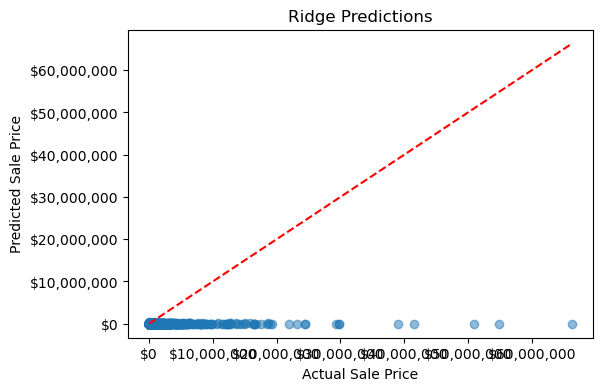


Model: SVR
Training RMSE: 3,740,776.59 | Test RMSE: 3,298,710.31
Training R^2: 0.05 | Test R^2: -0.01


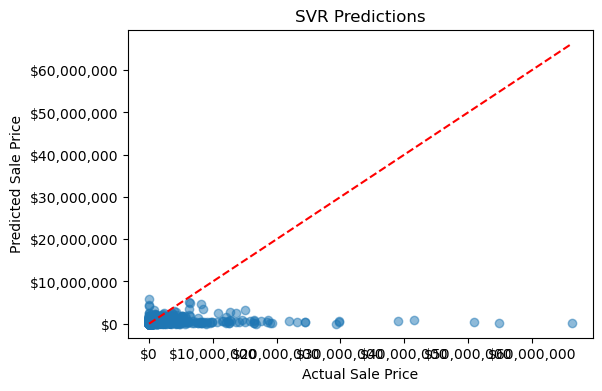


Model: RandomForest
Training RMSE: 3,838,130.01 | Test RMSE: 3,383,443.36
Training R^2: 0.00 | Test R^2: -0.07


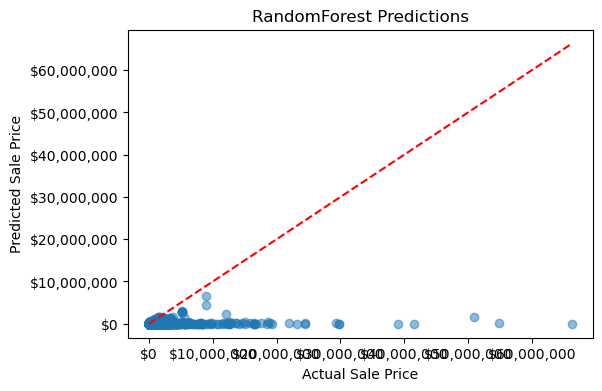

In [10]:
# -----------------------------
# 1. Import Libraries & Load Data
# -----------------------------
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import time

from sklearn.model_selection import train_test_split, GridSearchCV, KFold
from sklearn.linear_model import Ridge
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error, make_scorer, r2_score
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

# Load your CSV file (adjust the file path if necessary)
file_path = "../data/commericalnj.csv"
df2 = pd.read_csv(file_path, low_memory=False)

# -----------------------------
# 2. Data Cleaning & Feature Engineering Using .loc
# -----------------------------
# Convert 'Sale Date' to datetime and extract the sale year safely.
df2.loc[:, 'Sale Date'] = pd.to_datetime(df2.loc[:, 'Sale Date'], errors='coerce')
df2.loc[:, 'Sale Year'] = df2.loc[:, 'Sale Date'].apply(lambda x: x.year if pd.notnull(x) else np.nan)

# Convert key columns to numeric using .loc.
numeric_cols = ['Sq. Ft.', 'Yr. Built', 'Acreage', 'Sale Year', 'Latitude', 'Longitude', 'Sale Price']
for col in numeric_cols:
    df2.loc[:, col] = pd.to_numeric(df2.loc[:, col], errors='coerce')

# Define the initial features and target.
features_initial = ['Sq. Ft.', 'Yr. Built', 'Acreage', 'Sale Year', 'Latitude', 'Longitude']
target = 'Sale Price'

# Drop rows with missing values in any of the selected features or the target.
df_clean = df2.dropna(subset=features_initial + [target]).copy()

# Create a new feature: Building Age.
current_year = 2023  # Alternatively, use: current_year = pd.Timestamp.today().year
df_clean.loc[:, 'Building Age'] = current_year - df_clean.loc[:, 'Yr. Built']

# Apply a log transformation to the target variable to help reduce skewness.
df_clean.loc[:, 'Log Sale Price'] = np.log1p(df_clean.loc[:, target])

# Define the final set of features.
# We replace 'Yr. Built' with 'Building Age' for better interpretability.
features_final = ['Sq. Ft.', 'Acreage', 'Sale Year', 'Latitude', 'Longitude', 'Building Age']
target_transformed = 'Log Sale Price'

# -----------------------------
# 3. Train/Test Split
# -----------------------------
X = df_clean.loc[:, features_final]
y = df_clean.loc[:, target_transformed]

# Split the data into training (80%) and testing (20%) sets.
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

# -----------------------------
# 4. Define Pipelines and Hyperparameter Grids for Models
# -----------------------------
# For Ridge and SVR, scaling is important; RandomForest is less sensitive.
pipelines = {
    'Ridge': Pipeline([
        ('scaler', StandardScaler()),
        ('model', Ridge())
    ]),
    'SVR': Pipeline([
        ('scaler', StandardScaler()),
        ('model', SVR())
    ]),
    'RandomForest': Pipeline([
        ('model', RandomForestRegressor(random_state=42))
    ])
}

# Define hyperparameter grids (note the 'model__' prefix because of the pipeline structure).
param_grids = {
    'Ridge': {'model__alpha': [0.1, 1, 10]},
    'SVR': {'model__C': [0.1, 1, 10], 'model__epsilon': [0.1, 0.2]},
    'RandomForest': {'model__n_estimators': [50, 100], 'model__max_depth': [None, 5, 10]}
}

# Define an RMSE scorer (on the log-transformed target).
def rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))
rmse_scorer = make_scorer(rmse, greater_is_better=False)

# Set up 5-fold cross validation.
kf = KFold(n_splits=5, shuffle=True, random_state=42)

# Dictionary to store grid search results.
results = {}

# -----------------------------
# 5. Hyperparameter Tuning with GridSearchCV
# -----------------------------
for name, pipeline in pipelines.items():
    print(f"\nTuning model: {name}")
    grid = GridSearchCV(
        estimator=pipeline,
        param_grid=param_grids[name],
        cv=kf,
        scoring=rmse_scorer,
        n_jobs=-1
    )
    start_time = time.time()
    grid.fit(X_train, y_train)
    elapsed_time = time.time() - start_time
    
    # Since rmse_scorer returns a negative value, multiply by -1.
    best_rmse = -grid.best_score_
    best_params = grid.best_params_
    best_estimator = grid.best_estimator_
    
    results[name] = {
        'Best Estimator': best_estimator,
        'CV_RMSE': best_rmse,
        'Training_Time_sec': elapsed_time,
        'Best_Params': best_params
    }
    
    print(f"Best Params for {name}: {best_params}")
    print(f"CV RMSE for {name}: {best_rmse:.4f} (log scale)")
    print(f"Training Time for {name}: {elapsed_time:.2f} sec")

# -----------------------------
# 6. Model Evaluation and Visualization (with Custom Tick Formatting)
# -----------------------------
import matplotlib.ticker as ticker

print("\nModel Evaluation on Test Set (back-transformed to sale price scale):")
for name, res in results.items():
    model = res['Best Estimator']
    # Predict on training and test sets (predictions are in log scale).
    y_train_pred_log = model.predict(X_train)
    y_test_pred_log = model.predict(X_test)
    
    # Transform predictions back to the original sale price scale.
    y_train_pred = np.expm1(y_train_pred_log)
    y_test_pred = np.expm1(y_test_pred_log)
    y_train_actual = np.expm1(y_train)
    y_test_actual = np.expm1(y_test)
    
    # Compute RMSE and R² on the original scale.
    train_rmse = np.sqrt(mean_squared_error(y_train_actual, y_train_pred))
    test_rmse = np.sqrt(mean_squared_error(y_test_actual, y_test_pred))
    train_r2 = r2_score(y_train_actual, y_train_pred)
    test_r2 = r2_score(y_test_actual, y_test_pred)
    
    print(f"\nModel: {name}")
    print(f"Training RMSE: {train_rmse:,.2f} | Test RMSE: {test_rmse:,.2f}")
    print(f"Training R^2: {train_r2:.2f} | Test R^2: {test_r2:.2f}")
    
    # Plot predicted vs. actual sale prices.
    plt.figure(figsize=(6, 4))
    plt.scatter(y_test_actual, y_test_pred, alpha=0.5)
    plt.plot([y_test_actual.min(), y_test_actual.max()], 
             [y_test_actual.min(), y_test_actual.max()], 'r--')
    plt.xlabel("Actual Sale Price")
    plt.ylabel("Predicted Sale Price")
    plt.title(f"{name} Predictions")
    
    # Format the axes to display dollar amounts
    ax = plt.gca()
    formatter = ticker.FuncFormatter(lambda x, pos: f'${x:,.0f}')
    ax.xaxis.set_major_formatter(formatter)
    ax.yaxis.set_major_formatter(formatter)
    
    plt.show()


Best Params for XGBRegressor: {'regressor__learning_rate': 0.01, 'regressor__max_depth': 10, 'regressor__n_estimators': 200}
CV RMSE for XGBRegressor (log scale): 5.4429
Training Time: 45.55 sec

Model Evaluation on Test Set (back-transformed to sale price scale):
Training RMSE: 3,907,423.97 | Test RMSE: 3,399,897.26
Training R^2: -0.03 | Test R^2: -0.08


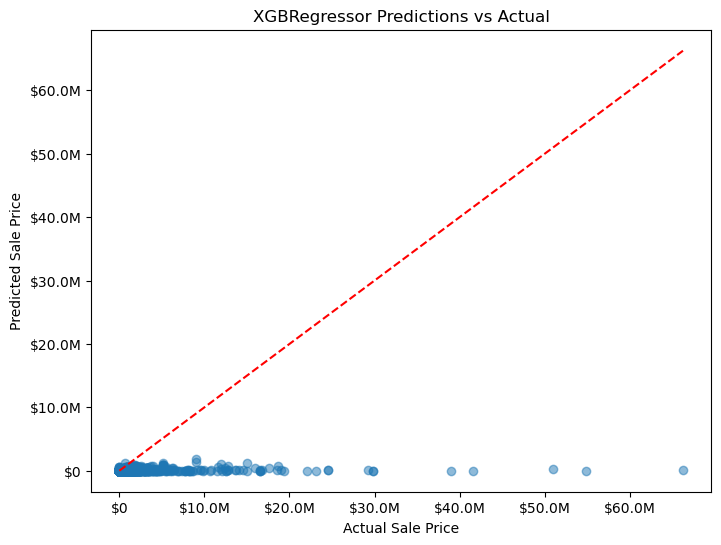

In [7]:
# -----------------------------
# 1. Import Libraries & Load Data
# -----------------------------
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import time

from sklearn.model_selection import train_test_split, GridSearchCV, KFold
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder

# Import XGBoost (install via pip install xgboost if needed)
!pip install xgboost
import xgboost as xgb

# Load your CSV file (adjust the file path if necessary)
file_path = "../data/commericalnj.csv"
df = pd.read_csv(file_path, low_memory=False)

# -----------------------------
# 2. Data Cleaning & Feature Engineering Using .loc
# -----------------------------
# Convert 'Sale Date' to datetime and extract the sale year safely.
df.loc[:, 'Sale Date'] = pd.to_datetime(df.loc[:, 'Sale Date'], errors='coerce')
df.loc[:, 'Sale Year'] = df.loc[:, 'Sale Date'].apply(lambda x: x.year if pd.notnull(x) else np.nan)

# Convert key columns to numeric.
numeric_cols = ['Sq. Ft.', 'Yr. Built', 'Acreage', 'Sale Year', 'Latitude', 'Longitude', 'Sale Price']
for col in numeric_cols:
    df.loc[:, col] = pd.to_numeric(df.loc[:, col], errors='coerce')

# We also want to include some categorical features.
# For example, 'Municipality' and 'Property Class' (adjust these based on your dataset).
selected_cols = ['Sq. Ft.', 'Yr. Built', 'Acreage', 'Sale Year', 'Latitude', 'Longitude', 
                 'Sale Price', 'Municipality', 'Property Class']

df_clean = df.dropna(subset=selected_cols).copy()

# Create a new feature: Building Age.
current_year = pd.Timestamp.today().year
df_clean.loc[:, 'Building Age'] = current_year - df_clean.loc[:, 'Yr. Built']

# Create the target by applying a log transformation to the sale price.
df_clean.loc[:, 'Log Sale Price'] = np.log1p(df_clean.loc[:, 'Sale Price'])

# -----------------------------
# 3. Define Features and Split the Data
# -----------------------------
# Numerical features for the model.
numerical_features = ['Sq. Ft.', 'Acreage', 'Building Age', 'Sale Year', 'Latitude', 'Longitude']
# Categorical features that are likely influential.
categorical_features = ['Municipality', 'Property Class']

# Combine into a single feature list.
features = numerical_features + categorical_features
target = 'Log Sale Price'

# Split the data into training (80%) and testing (20%) sets.
X = df_clean.loc[:, features]
y = df_clean.loc[:, target]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# -----------------------------
# 4. Create a Preprocessing Pipeline with ColumnTransformer
# -----------------------------
# For numerical features, apply StandardScaler; for categorical, apply OneHotEncoder.
preprocessor = ColumnTransformer(transformers=[
    ('num', StandardScaler(), numerical_features),
    ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
])

# -----------------------------
# 5. Build the Model Pipeline with XGBoostRegressor
# -----------------------------
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', xgb.XGBRegressor(objective='reg:squarederror', random_state=42))
])

# -----------------------------
# 6. Hyperparameter Tuning with GridSearchCV
# -----------------------------
# Define a hyperparameter grid for XGBoost.
param_grid = {
    'regressor__n_estimators': [100, 200],
    'regressor__max_depth': [3, 6, 10],
    'regressor__learning_rate': [0.01, 0.1, 0.2]
}

kf = KFold(n_splits=5, shuffle=True, random_state=42)
grid_search = GridSearchCV(pipeline, param_grid, cv=kf, scoring='neg_root_mean_squared_error', n_jobs=-1)

start_time = time.time()
grid_search.fit(X_train, y_train)
elapsed_time = time.time() - start_time

best_params = grid_search.best_params_
cv_rmse = -grid_search.best_score_  # (This RMSE is on the log-transformed target)
best_estimator = grid_search.best_estimator_

print("Best Params for XGBRegressor:", best_params)
print(f"CV RMSE for XGBRegressor (log scale): {cv_rmse:.4f}")
print(f"Training Time: {elapsed_time:.2f} sec")

# -----------------------------
# 7. Model Evaluation on the Test Set
# -----------------------------
# Predict on training and test sets (predictions are in log scale).
y_train_pred_log = best_estimator.predict(X_train)
y_test_pred_log = best_estimator.predict(X_test)

# Convert predictions back to the original sale price scale.
y_train_pred = np.expm1(y_train_pred_log)
y_test_pred = np.expm1(y_test_pred_log)
y_train_actual = np.expm1(y_train)
y_test_actual = np.expm1(y_test)

train_rmse = np.sqrt(mean_squared_error(y_train_actual, y_train_pred))
test_rmse = np.sqrt(mean_squared_error(y_test_actual, y_test_pred))
train_r2 = r2_score(y_train_actual, y_train_pred)
test_r2 = r2_score(y_test_actual, y_test_pred)

print("\nModel Evaluation on Test Set (back-transformed to sale price scale):")
print(f"Training RMSE: {train_rmse:,.2f} | Test RMSE: {test_rmse:,.2f}")
print(f"Training R^2: {train_r2:.2f} | Test R^2: {test_r2:.2f}")

# -----------------------------
# 8. Plot Predicted vs. Actual Sale Prices with Abbreviated Axis Labels
# -----------------------------
import matplotlib.ticker as ticker

plt.figure(figsize=(8, 6))
plt.scatter(y_test_actual, y_test_pred, alpha=0.5)
plt.plot([y_test_actual.min(), y_test_actual.max()], 
         [y_test_actual.min(), y_test_actual.max()], 'r--')
plt.xlabel("Actual Sale Price")
plt.ylabel("Predicted Sale Price")
plt.title("XGBRegressor Predictions vs Actual")

# Use a custom formatter to abbreviate large dollar amounts (e.g., $3.5M)
ax = plt.gca()
def millions_formatter(x, pos):
    if x >= 1e6:
        return f'${x/1e6:.1f}M'
    else:
        return f'${x:.0f}'
formatter = ticker.FuncFormatter(millions_formatter)
ax.xaxis.set_major_formatter(formatter)
ax.yaxis.set_major_formatter(formatter)

plt.show()


Best Params for XGBRegressor: {'regressor__learning_rate': 0.1, 'regressor__max_depth': 6, 'regressor__n_estimators': 200}
CV RMSE for XGBRegressor (log scale): 0.5823
Training Time: 3.41 sec

Model Evaluation on Test Set (back-transformed to sale price scale):
Training RMSE: 2,430,384.90 | Test RMSE: 5,297,899.39
Training R^2: 0.79 | Test R^2: 0.42


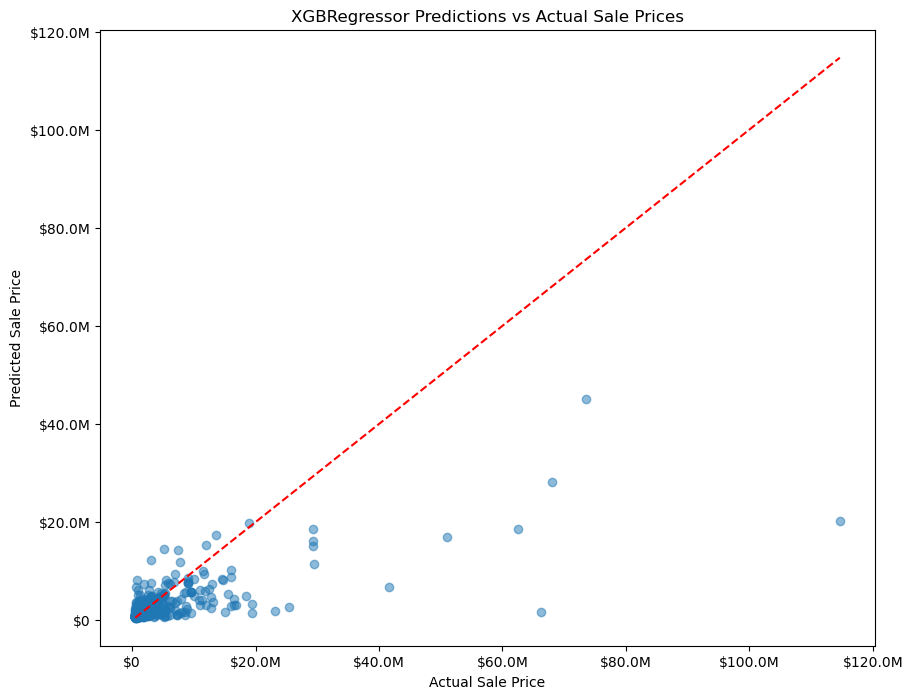

In [10]:
# -----------------------------
# 1. Import Libraries & Load Data
# -----------------------------
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import time

from sklearn.model_selection import train_test_split, GridSearchCV, KFold
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder

import xgboost as xgb
import matplotlib.ticker as ticker

# Adjust file path as needed
file_path = "../data/commericalnj.csv"
df = pd.read_csv(file_path, low_memory=False)

# -----------------------------
# 2. Data Cleaning & Outlier Removal
# -----------------------------
# Convert 'Sale Date' to datetime and extract 'Sale Year'
df.loc[:, 'Sale Date'] = pd.to_datetime(df.loc[:, 'Sale Date'], errors='coerce')
df.loc[:, 'Sale Year'] = df.loc[:, 'Sale Date'].apply(lambda x: x.year if pd.notnull(x) else np.nan)

# Convert key numeric columns to numbers
numeric_cols = ['Sq. Ft.', 'Yr. Built', 'Acreage', 'Latitude', 'Longitude', 'Sale Price']
for col in numeric_cols:
    df.loc[:, col] = pd.to_numeric(df.loc[:, col], errors='coerce')

# -----------------------------
# 3. Remove Irregular Transactions
# -----------------------------
# Filter out transactions with a sale price below a threshold (e.g., $50,000)
threshold = 500000
df_market = df[df['Sale Price'] >= threshold].copy()

# -----------------------------
# 4. Feature Engineering on the Cleaned DataFrame
# -----------------------------
# Define the key columns we want to use
selected_cols = ['Sq. Ft.', 'Yr. Built', 'Acreage', 'Sale Year', 'Latitude', 'Longitude',
                 'Sale Price', 'Municipality', 'Property Class', 'Type/Use']

# Drop rows missing any of these key features in our filtered dataframe
df_market = df_market.dropna(subset=selected_cols).copy()

# Create a derived feature: Building Age (current year minus Yr. Built)
current_year = pd.Timestamp.today().year
df_market.loc[:, 'Building Age'] = current_year - df_market.loc[:, 'Yr. Built']

# Create the target variable: use a log transformation on Sale Price (to reduce skew)
df_market.loc[:, 'Log Sale Price'] = np.log1p(df_market.loc[:, 'Sale Price'])

# -----------------------------
# 5. Define Feature Sets and Split Data
# -----------------------------
# Numerical features: building metrics and location coordinates
numerical_features = ['Sq. Ft.', 'Acreage', 'Building Age', 'Sale Year', 'Latitude', 'Longitude']

# Categorical features: location and property type details
categorical_features = ['Municipality', 'Property Class', 'Type/Use']

# Final feature list and target
features = numerical_features + categorical_features
target = 'Log Sale Price'

X = df_market.loc[:, features]
y = df_market.loc[:, target]

# Split the data into training (80%) and test (20%) sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# -----------------------------
# 6. Create a Preprocessing Pipeline
# -----------------------------
# For numerical features, use StandardScaler; for categorical features, use OneHotEncoder.
preprocessor = ColumnTransformer(transformers=[
    ('num', StandardScaler(), numerical_features),
    ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
])

# -----------------------------
# 7. Build the Model Pipeline with XGBoost
# -----------------------------
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', xgb.XGBRegressor(objective='reg:squarederror', random_state=42))
])

# -----------------------------
# 8. Hyperparameter Tuning with GridSearchCV
# -----------------------------
param_grid = {
    'regressor__n_estimators': [100, 200],
    'regressor__max_depth': [3, 6, 10],
    'regressor__learning_rate': [0.01, 0.1, 0.2]
}

kf = KFold(n_splits=5, shuffle=True, random_state=42)
grid_search = GridSearchCV(pipeline, param_grid, cv=kf,
                           scoring='neg_root_mean_squared_error', n_jobs=-1)

start_time = time.time()
grid_search.fit(X_train, y_train)
elapsed_time = time.time() - start_time

best_params = grid_search.best_params_
cv_rmse = -grid_search.best_score_  # (This RMSE is on the log-transformed target)
best_estimator = grid_search.best_estimator_

print("Best Params for XGBRegressor:", best_params)
print(f"CV RMSE for XGBRegressor (log scale): {cv_rmse:.4f}")
print(f"Training Time: {elapsed_time:.2f} sec")

# -----------------------------
# 9. Model Evaluation on Test Set (Back-Transformed)
# -----------------------------
# Predict on training and test sets (predictions are in log scale)
y_train_pred_log = best_estimator.predict(X_train)
y_test_pred_log = best_estimator.predict(X_test)

# Convert predictions back to the original sale price scale
y_train_pred = np.expm1(y_train_pred_log)
y_test_pred = np.expm1(y_test_pred_log)
y_train_actual = np.expm1(y_train)
y_test_actual = np.expm1(y_test)

train_rmse = np.sqrt(mean_squared_error(y_train_actual, y_train_pred))
test_rmse = np.sqrt(mean_squared_error(y_test_actual, y_test_pred))
train_r2 = r2_score(y_train_actual, y_train_pred)
test_r2 = r2_score(y_test_actual, y_test_pred)

print("\nModel Evaluation on Test Set (back-transformed to sale price scale):")
print(f"Training RMSE: {train_rmse:,.2f} | Test RMSE: {test_rmse:,.2f}")
print(f"Training R^2: {train_r2:.2f} | Test R^2: {test_r2:.2f}")

# -----------------------------
# 10. Plot Predicted vs. Actual Sale Prices with Abbreviated Axes
# -----------------------------
plt.figure(figsize=(10, 8))
plt.scatter(y_test_actual, y_test_pred, alpha=0.5)
plt.plot([y_test_actual.min(), y_test_actual.max()], 
         [y_test_actual.min(), y_test_actual.max()], 'r--')
plt.xlabel("Actual Sale Price")
plt.ylabel("Predicted Sale Price")
plt.title("XGBRegressor Predictions vs Actual Sale Prices")

ax = plt.gca()
def millions_formatter(x, pos):
    if x >= 1e6:
        return f'${x/1e6:.1f}M'
    else:
        return f'${x:.0f}'
formatter = ticker.FuncFormatter(millions_formatter)
ax.xaxis.set_major_formatter(formatter)
ax.yaxis.set_major_formatter(formatter)

plt.show()


Best Params for XGBRegressor: {'regressor__learning_rate': 0.2, 'regressor__max_depth': 6, 'regressor__n_estimators': 200}
CV RMSE for XGBRegressor (log scale): 0.4922
Training Time: 58.39 sec

Model Evaluation on Test Set (back-transformed to sale price scale):
Training RMSE: 1,339,148.00 | Test RMSE: 2,840,324.76
Training R^2: 0.94 | Test R^2: 0.57


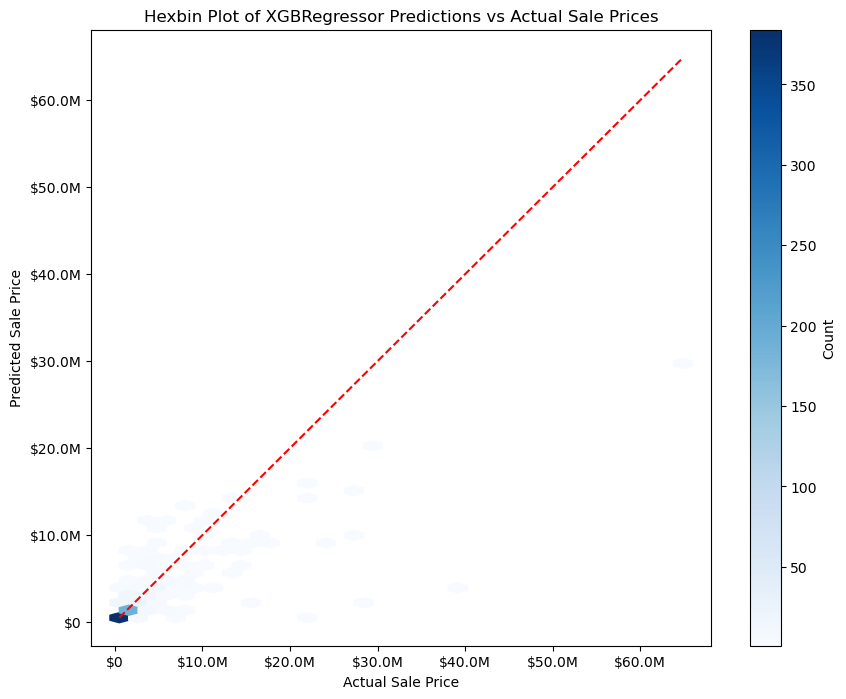

In [8]:
# -----------------------------
# 1. Import Libraries & Load Data
# -----------------------------
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import time

from sklearn.model_selection import train_test_split, GridSearchCV, KFold
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder

import xgboost as xgb
import matplotlib.ticker as ticker

# Adjust file path as needed
file_path = "../data/commericalnj.csv"
df = pd.read_csv(file_path, low_memory=False)

# -----------------------------
# 2. Data Cleaning & Outlier Removal
# -----------------------------
# Convert 'Sale Date' to datetime and extract 'Sale Year'
df.loc[:, 'Sale Date'] = pd.to_datetime(df.loc[:, 'Sale Date'], errors='coerce')
df.loc[:, 'Sale Year'] = df.loc[:, 'Sale Date'].apply(lambda x: x.year if pd.notnull(x) else np.nan)

# Convert key numeric columns to numbers
numeric_cols = ['Sq. Ft.', 'Yr. Built', 'Acreage', 'Latitude', 'Longitude', 'Sale Price',
                'Total Assmnt', 'Taxes 1']
for col in numeric_cols:
    df.loc[:, col] = pd.to_numeric(df.loc[:, col], errors='coerce')

# -----------------------------
# 3. Remove Irregular Transactions
# -----------------------------
# Filter out transactions with a sale price below $500,000
threshold = 500000
df_market = df[df['Sale Price'] >= threshold].copy()

# -----------------------------
# 4. Feature Engineering on the Cleaned DataFrame
# -----------------------------
# Define the key columns to use. Here we include additional features: 
# Total Assessed Value ("Total Assmnt"), Property Tax ("Taxes 1"), and Neighborhood ("Neigh").
selected_cols = ['Sq. Ft.', 'Yr. Built', 'Acreage', 'Sale Year', 'Latitude', 'Longitude', 
                 'Sale Price', 'Municipality', 'Property Class', 'Type/Use', 'Total Assmnt', 'Taxes 1', 'Neigh']

df_market = df_market.dropna(subset=selected_cols).copy()

# Create a derived feature: Building Age (current year minus Yr. Built)
current_year = pd.Timestamp.today().year
df_market.loc[:, 'Building Age'] = current_year - df_market.loc[:, 'Yr. Built']

# Create the target variable: apply a log transformation on Sale Price to reduce skewness
df_market.loc[:, 'Log Sale Price'] = np.log1p(df_market.loc[:, 'Sale Price'])

# -----------------------------
# 5. Define Feature Sets and Split Data
# -----------------------------
# Numerical features (continuous values)
numerical_features = ['Sq. Ft.', 'Acreage', 'Building Age', 'Sale Year', 'Latitude', 'Longitude', 
                      'Total Assmnt', 'Taxes 1']

# Categorical features (non-numeric values)
categorical_features = ['Municipality', 'Property Class', 'Type/Use', 'Neigh']

# Final feature list and target variable
features = numerical_features + categorical_features
target = 'Log Sale Price'

X = df_market.loc[:, features]
y = df_market.loc[:, target]

# Split the data into training (80%) and testing (20%) sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# -----------------------------
# 6. Create a Preprocessing Pipeline
# -----------------------------
# For numerical features, apply StandardScaler; for categorical features, apply OneHotEncoder.
preprocessor = ColumnTransformer(transformers=[
    ('num', StandardScaler(), numerical_features),
    ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
])

# -----------------------------
# 7. Build the Model Pipeline with XGBoost
# -----------------------------
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', xgb.XGBRegressor(objective='reg:squarederror', random_state=42))
])

# -----------------------------
# 8. Hyperparameter Tuning with GridSearchCV
# -----------------------------
param_grid = {
    'regressor__n_estimators': [100, 200],
    'regressor__max_depth': [3, 6, 10],
    'regressor__learning_rate': [0.01, 0.1, 0.2]
}

kf = KFold(n_splits=5, shuffle=True, random_state=42)
grid_search = GridSearchCV(pipeline, param_grid, cv=kf,
                           scoring='neg_root_mean_squared_error', n_jobs=-1)

start_time = time.time()
grid_search.fit(X_train, y_train)
elapsed_time = time.time() - start_time

best_params = grid_search.best_params_
cv_rmse = -grid_search.best_score_  # RMSE is computed on the log-transformed target
best_estimator = grid_search.best_estimator_

print("Best Params for XGBRegressor:", best_params)
print(f"CV RMSE for XGBRegressor (log scale): {cv_rmse:.4f}")
print(f"Training Time: {elapsed_time:.2f} sec")

# -----------------------------
# 9. Model Evaluation on Test Set (Back-Transformed)
# -----------------------------
# Predict on the training and test sets (predictions are in log scale)
y_train_pred_log = best_estimator.predict(X_train)
y_test_pred_log = best_estimator.predict(X_test)

# Convert predictions back to the original sale price scale
y_train_pred = np.expm1(y_train_pred_log)
y_test_pred = np.expm1(y_test_pred_log)
y_train_actual = np.expm1(y_train)
y_test_actual = np.expm1(y_test)

train_rmse = np.sqrt(mean_squared_error(y_train_actual, y_train_pred))
test_rmse = np.sqrt(mean_squared_error(y_test_actual, y_test_pred))
train_r2 = r2_score(y_train_actual, y_train_pred)
test_r2 = r2_score(y_test_actual, y_test_pred)

print("\nModel Evaluation on Test Set (back-transformed to sale price scale):")
print(f"Training RMSE: {train_rmse:,.2f} | Test RMSE: {test_rmse:,.2f}")
print(f"Training R^2: {train_r2:.2f} | Test R^2: {test_r2:.2f}")

# -----------------------------
# 10. Plot Predicted vs. Actual Sale Prices with Abbreviated Axes
# -----------------------------
plt.figure(figsize=(10, 8))
hb = plt.hexbin(y_test_actual, y_test_pred, gridsize=30, cmap='Blues', mincnt=1)
plt.plot([y_test_actual.min(), y_test_actual.max()], 
         [y_test_actual.min(), y_test_actual.max()], 'r--')
plt.xlabel("Actual Sale Price")
plt.ylabel("Predicted Sale Price")
plt.title("Hexbin Plot of XGBRegressor Predictions vs Actual Sale Prices")

ax = plt.gca()
def millions_formatter(x, pos):
    if x >= 1e6:
        return f'${x/1e6:.1f}M'
    else:
        return f'${x:.0f}'
formatter = ticker.FuncFormatter(millions_formatter)
ax.xaxis.set_major_formatter(formatter)
ax.yaxis.set_major_formatter(formatter)
plt.colorbar(hb, label='Count')
plt.show()


Best Params for XGBRegressor: {'regressor__learning_rate': 0.1, 'regressor__max_depth': 6, 'regressor__n_estimators': 100}
CV RMSE for XGBRegressor (log scale): 0.4104
Training Time: 4.22 sec

Model Evaluation on Test Set (back-transformed to sale price scale):
Training RMSE: 718,358.97 | Test RMSE: 1,218,712.08
Training R^2: 0.87 | Test R^2: 0.64


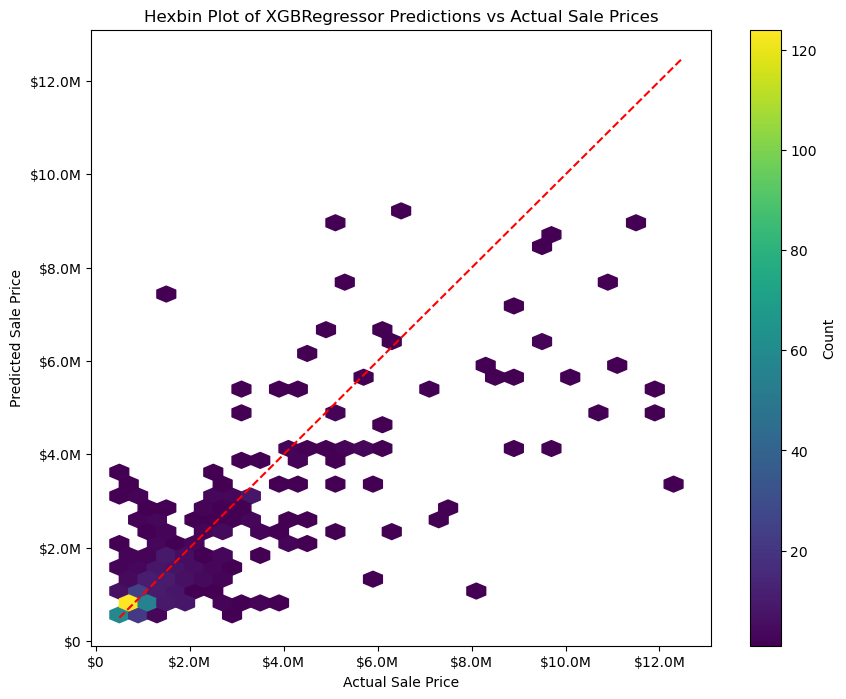

In [12]:
# -----------------------------
# 1. Import Libraries & Load Data
# -----------------------------
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import time

from sklearn.model_selection import train_test_split, GridSearchCV, KFold
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.feature_extraction.text import TfidfVectorizer

import xgboost as xgb
import matplotlib.ticker as ticker

# Adjust file path as needed
file_path = "../data/commericalnj.csv"
df = pd.read_csv(file_path, low_memory=False)

# -----------------------------
# 2. Data Cleaning & Time Feature Extraction
# -----------------------------
# Convert 'Sale Date' to datetime and extract time features.
df.loc[:, 'Sale Date'] = pd.to_datetime(df.loc[:, 'Sale Date'], errors='coerce')
df.loc[:, 'Sale Year'] = df.loc[:, 'Sale Date'].apply(lambda x: x.year if pd.notnull(x) else np.nan)
df.loc[:, 'Sale Month'] = df.loc[:, 'Sale Date'].apply(lambda x: x.month if pd.notnull(x) else np.nan)

# Create cyclic features for Sale Month to capture seasonality.
df.loc[:, 'Sale Month Sine'] = np.sin(2 * np.pi * df.loc[:, 'Sale Month'] / 12)
df.loc[:, 'Sale Month Cosine'] = np.cos(2 * np.pi * df.loc[:, 'Sale Month'] / 12)

# Convert key numeric columns to numbers.
numeric_cols = ['Sq. Ft.', 'Yr. Built', 'Acreage', 'Latitude', 'Longitude', 'Sale Price',
                'Total Assmnt', 'Taxes 1']
for col in numeric_cols:
    df.loc[:, col] = pd.to_numeric(df.loc[:, col], errors='coerce')

# -----------------------------
# 3. Remove Irregular Transactions & Extreme Outliers
# -----------------------------
# Filter out transactions with a sale price below $500,000.
threshold = 500000
df_market = df[df['Sale Price'] >= threshold].copy()

# Remove extreme outliers (for example, properties above the 95th percentile).
upper_threshold = df_market['Sale Price'].quantile(0.95)
df_market = df_market[df_market['Sale Price'] <= upper_threshold].copy()

# -----------------------------
# 4. Feature Engineering on the Cleaned DataFrame
# -----------------------------
# Define the key columns to use.
# We add additional features, including property text descriptions.
selected_cols = ['Sq. Ft.', 'Yr. Built', 'Acreage', 'Sale Year', 'Sale Month Sine', 'Sale Month Cosine',
                 'Latitude', 'Longitude', 'Sale Price', 'Municipality', 'Property Class', 'Type/Use',
                 'Total Assmnt', 'Taxes 1', 'Neigh', 'Building Desc', 'Land Desc']

df_market = df_market.dropna(subset=selected_cols).copy()

# Create a derived feature: Building Age (current year minus Yr. Built)
current_year = pd.Timestamp.today().year
df_market.loc[:, 'Building Age'] = current_year - df_market.loc[:, 'Yr. Built']

# Create a combined text feature from building and land descriptions.
df_market.loc[:, 'Combined Desc'] = df_market['Building Desc'].fillna('') + " " + df_market['Land Desc'].fillna('')

# Create the target variable: apply a log transformation on Sale Price to reduce skewness.
df_market.loc[:, 'Log Sale Price'] = np.log1p(df_market.loc[:, 'Sale Price'])

# -----------------------------
# 5. Define Feature Sets and Split Data
# -----------------------------
# Numerical features (continuous values)
numerical_features = ['Sq. Ft.', 'Acreage', 'Building Age', 'Sale Year', 'Sale Month Sine', 'Sale Month Cosine',
                      'Latitude', 'Longitude', 'Total Assmnt', 'Taxes 1']

# Categorical features (non-numeric values)
categorical_features = ['Municipality', 'Property Class', 'Type/Use', 'Neigh']

# Text features (from property descriptions)
text_features = ['Combined Desc']

# Final feature list and target variable.
# We'll combine numerical, categorical, and text features.
features = numerical_features + categorical_features + text_features
target = 'Log Sale Price'

X = df_market.loc[:, features]
y = df_market.loc[:, target]

# Split the data into training (80%) and testing (20%) sets.
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# -----------------------------
# 6. Create a Preprocessing Pipeline
# -----------------------------
# Create transformers for each type of feature.
preprocessor = ColumnTransformer(transformers=[
    ('num', StandardScaler(), numerical_features),
    ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features),
    ('text', TfidfVectorizer(max_features=100), 'Combined Desc')
])

# -----------------------------
# 7. Build the Model Pipeline with XGBoost
# -----------------------------
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', xgb.XGBRegressor(objective='reg:squarederror', random_state=42))
])

# -----------------------------
# 8. Hyperparameter Tuning with GridSearchCV
# -----------------------------
param_grid = {
    'regressor__n_estimators': [100, 200],
    'regressor__max_depth': [3, 6, 10],
    'regressor__learning_rate': [0.01, 0.1, 0.2]
}

kf = KFold(n_splits=5, shuffle=True, random_state=42)
grid_search = GridSearchCV(pipeline, param_grid, cv=kf,
                           scoring='neg_root_mean_squared_error', n_jobs=-1)

start_time = time.time()
grid_search.fit(X_train, y_train)
elapsed_time = time.time() - start_time

best_params = grid_search.best_params_
cv_rmse = -grid_search.best_score_  # RMSE on the log-transformed target.
best_estimator = grid_search.best_estimator_

print("Best Params for XGBRegressor:", best_params)
print(f"CV RMSE for XGBRegressor (log scale): {cv_rmse:.4f}")
print(f"Training Time: {elapsed_time:.2f} sec")

# -----------------------------
# 9. Model Evaluation on Test Set (Back-Transformed)
# -----------------------------
# Predict on the training and test sets (predictions are in log scale).
y_train_pred_log = best_estimator.predict(X_train)
y_test_pred_log = best_estimator.predict(X_test)

# Convert predictions back to the original sale price scale.
y_train_pred = np.expm1(y_train_pred_log)
y_test_pred = np.expm1(y_test_pred_log)
y_train_actual = np.expm1(y_train)
y_test_actual = np.expm1(y_test)

train_rmse = np.sqrt(mean_squared_error(y_train_actual, y_train_pred))
test_rmse = np.sqrt(mean_squared_error(y_test_actual, y_test_pred))
train_r2 = r2_score(y_train_actual, y_train_pred)
test_r2 = r2_score(y_test_actual, y_test_pred)

print("\nModel Evaluation on Test Set (back-transformed to sale price scale):")
print(f"Training RMSE: {train_rmse:,.2f} | Test RMSE: {test_rmse:,.2f}")
print(f"Training R^2: {train_r2:.2f} | Test R^2: {test_r2:.2f}")

# -----------------------------
# 10. Plot Predicted vs. Actual Sale Prices with Abbreviated Axes
# -----------------------------
plt.figure(figsize=(10, 8))
hb = plt.hexbin(y_test_actual, y_test_pred, gridsize=30, cmap='viridis', mincnt=1)
plt.plot([y_test_actual.min(), y_test_actual.max()], 
         [y_test_actual.min(), y_test_actual.max()], 'r--')
plt.xlabel("Actual Sale Price")
plt.ylabel("Predicted Sale Price")
plt.title("Hexbin Plot of XGBRegressor Predictions vs Actual Sale Prices")

ax = plt.gca()
def millions_formatter(x, pos):
    if x >= 1e6:
        return f'${x/1e6:.1f}M'
    else:
        return f'${x:.0f}'
formatter = ticker.FuncFormatter(millions_formatter)
ax.xaxis.set_major_formatter(formatter)
ax.yaxis.set_major_formatter(formatter)
cb = plt.colorbar(hb)
cb.set_label('Count')

plt.show()


Best Params for XGBRegressor: {'regressor__learning_rate': 0.1, 'regressor__max_depth': 6, 'regressor__n_estimators': 200}
CV RMSE for XGBRegressor (log scale): 0.4231
Training Time: 60.09 sec

Model Evaluation on Test Set (back-transformed to sale price scale):
Training RMSE: 716,082.66 | Test RMSE: 1,013,728.38
Training R²: 0.87 | Test R²: 0.68


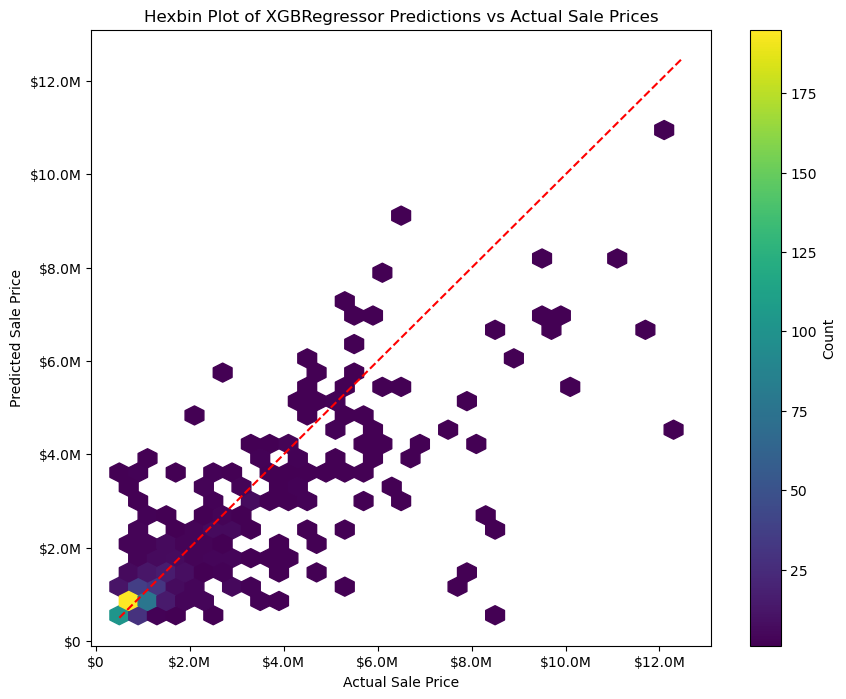

In [9]:
# -----------------------------
# 1. Import Libraries & Load Data
# -----------------------------
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import time

from sklearn.model_selection import train_test_split, GridSearchCV, KFold
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder

import xgboost as xgb
import matplotlib.ticker as ticker

# Adjust file path as needed
file_path = "../data/commericalnj.csv"
df = pd.read_csv(file_path, low_memory=False)

# -----------------------------
# 2. Data Cleaning & Time Feature Extraction
# -----------------------------
# Convert 'Sale Date' to datetime and extract time features.
df.loc[:, 'Sale Date'] = pd.to_datetime(df.loc[:, 'Sale Date'], errors='coerce')
df.loc[:, 'Sale Year'] = df.loc[:, 'Sale Date'].apply(lambda x: x.year if pd.notnull(x) else np.nan)
df.loc[:, 'Sale Month'] = df.loc[:, 'Sale Date'].apply(lambda x: x.month if pd.notnull(x) else np.nan)

# Create cyclic features for Sale Month to capture seasonality.
df.loc[:, 'Sale Month Sine'] = np.sin(2 * np.pi * df.loc[:, 'Sale Month'] / 12)
df.loc[:, 'Sale Month Cosine'] = np.cos(2 * np.pi * df.loc[:, 'Sale Month'] / 12)

# Convert key numeric columns to numbers.
numeric_cols = ['Sq. Ft.', 'Yr. Built', 'Acreage', 'Latitude', 'Longitude', 'Sale Price',
                'Total Assmnt', 'Taxes 1']
for col in numeric_cols:
    df.loc[:, col] = pd.to_numeric(df.loc[:, col], errors='coerce')

# -----------------------------
# 3. Remove Irregular Transactions & Extreme Outliers
# -----------------------------
# Filter out transactions with a sale price below $500,000.
threshold_min = 500000
df_market = df[df['Sale Price'] >= threshold_min].copy()

# Remove extreme outliers: remove properties above the 95th percentile.
upper_threshold = df_market['Sale Price'].quantile(0.95)
df_market = df_market[df_market['Sale Price'] <= upper_threshold].copy()

# -----------------------------
# 4. Feature Engineering on the Cleaned DataFrame
# -----------------------------
# Define the key columns to use. Note: We use "Total Assmnt" as it appears in the CSV.
selected_cols = ['Sq. Ft.', 'Yr. Built', 'Acreage', 'Sale Year', 'Sale Month Sine', 'Sale Month Cosine',
                 'Latitude', 'Longitude', 'Sale Price', 'Municipality', 'Property Class', 'Type/Use',
                 'Total Assmnt', 'Taxes 1', 'Neigh']
df_market = df_market.dropna(subset=selected_cols).copy()

# Create a derived feature: Building Age (current year minus Yr. Built)
current_year = pd.Timestamp.today().year
df_market.loc[:, 'Building Age'] = current_year - df_market.loc[:, 'Yr. Built']

# Create the target variable: apply a log transformation on Sale Price to reduce skewness.
df_market.loc[:, 'Log Sale Price'] = np.log1p(df_market.loc[:, 'Sale Price'])

# -----------------------------
# 5. Define Feature Sets and Prepare Data
# -----------------------------
# Numerical features (continuous values)
numerical_features = ['Sq. Ft.', 'Acreage', 'Building Age', 'Sale Year', 'Sale Month Sine', 'Sale Month Cosine',
                      'Latitude', 'Longitude', 'Total Assmnt', 'Taxes 1']

# Categorical features (non-numeric values)
categorical_features = ['Municipality', 'Property Class', 'Type/Use', 'Neigh']

features = numerical_features + categorical_features
target = 'Log Sale Price'

X = df_market.loc[:, features]
y = df_market.loc[:, target]

# Replace infinite values with NaN and then drop those rows.
X.replace([np.inf, -np.inf], np.nan, inplace=True)
y.replace([np.inf, -np.inf], np.nan, inplace=True)
X.dropna(inplace=True)
y = y.loc[X.index]

# Split the data into training (80%) and testing (20%) sets.
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# -----------------------------
# 6. Create a Preprocessing Pipeline
# -----------------------------
# For numerical features, apply StandardScaler; for categorical features, apply OneHotEncoder.
preprocessor = ColumnTransformer(transformers=[
    ('num', StandardScaler(), numerical_features),
    ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
])

# -----------------------------
# 7. Build the Model Pipeline with XGBoost
# -----------------------------
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', xgb.XGBRegressor(objective='reg:squarederror', random_state=42))
])

# -----------------------------
# 8. Hyperparameter Tuning with GridSearchCV
# -----------------------------
param_grid = {
    'regressor__n_estimators': [100, 200],
    'regressor__max_depth': [3, 6, 10],
    'regressor__learning_rate': [0.01, 0.1, 0.2]
}

kf = KFold(n_splits=5, shuffle=True, random_state=42)
grid_search = GridSearchCV(pipeline, param_grid, cv=kf,
                           scoring='neg_root_mean_squared_error', n_jobs=-1)

start_time = time.time()
grid_search.fit(X_train, y_train)
elapsed_time = time.time() - start_time

best_params = grid_search.best_params_
cv_rmse = -grid_search.best_score_  # RMSE on the log-transformed target
best_estimator = grid_search.best_estimator_

print("Best Params for XGBRegressor:", best_params)
print(f"CV RMSE for XGBRegressor (log scale): {cv_rmse:.4f}")
print(f"Training Time: {elapsed_time:.2f} sec")

# -----------------------------
# 9. Model Evaluation on Test Set (Back-Transformed)
# -----------------------------
# Predict on the training and test sets (predictions are in log scale).
y_train_pred_log = best_estimator.predict(X_train)
y_test_pred_log = best_estimator.predict(X_test)

# Convert predictions back to the original sale price scale.
y_train_pred = np.expm1(y_train_pred_log)
y_test_pred = np.expm1(y_test_pred_log)
y_train_actual = np.expm1(y_train)
y_test_actual = np.expm1(y_test)

train_rmse = np.sqrt(mean_squared_error(y_train_actual, y_train_pred))
test_rmse = np.sqrt(mean_squared_error(y_test_actual, y_test_pred))
train_r2 = r2_score(y_train_actual, y_train_pred)
test_r2 = r2_score(y_test_actual, y_test_pred)

print("\nModel Evaluation on Test Set (back-transformed to sale price scale):")
print(f"Training RMSE: {train_rmse:,.2f} | Test RMSE: {test_rmse:,.2f}")
print(f"Training R²: {train_r2:.2f} | Test R²: {test_r2:.2f}")

# -----------------------------
# 10. Plot Predicted vs. Actual Sale Prices with Abbreviated Axes
# -----------------------------
plt.figure(figsize=(10, 8))
plt.hexbin(y_test_actual, y_test_pred, gridsize=30, cmap='viridis', mincnt=1)
plt.plot([y_test_actual.min(), y_test_actual.max()], 
         [y_test_actual.min(), y_test_actual.max()], 'r--')
plt.xlabel("Actual Sale Price")
plt.ylabel("Predicted Sale Price")
plt.title("Hexbin Plot of XGBRegressor Predictions vs Actual Sale Prices")

ax = plt.gca()
def millions_formatter(x, pos):
    if x >= 1e6:
        return f'${x/1e6:.1f}M'
    else:
        return f'${x:.0f}'
ax.xaxis.set_major_formatter(ticker.FuncFormatter(millions_formatter))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(millions_formatter))
cb = plt.colorbar()
cb.set_label('Count')
plt.show()



# Real Estate Price Prediction Model using XGBoost

## Overview
This notebook predicts commercial property sale prices using an XGBoost regression model. The workflow includes:
- Data ingestion and cleaning
- Time-based and derived feature engineering
- Feature selection and data splitting
- Preprocessing with scaling and one-hot encoding
- Model training with hyperparameter tuning using GridSearchCV
- Model evaluation on both the log-transformed target and back-transformed sale price scale
- Visualization of predictions vs. actual sale prices

## 1. Import Libraries & Load Data
We start by importing the necessary libraries for data manipulation, modeling, and visualization. We then load the CSV file into a Pandas DataFrame.

```python
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import time

from sklearn.model_selection import train_test_split, GridSearchCV, KFold
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder

import xgboost as xgb
import matplotlib.ticker as ticker

# Adjust file path as needed
file_path = "../data/commericalnj.csv"
df = pd.read_csv(file_path, low_memory=False)
```

## 2. Data Cleaning & Time Feature Extraction
We convert the "Sale Date" column to datetime and extract the year and month. Then we create cyclic features (sine and cosine) for the month to capture seasonal patterns. We also ensure key numeric columns are in numeric format.

```python
# Convert 'Sale Date' to datetime and extract time features.
df.loc[:, 'Sale Date'] = pd.to_datetime(df.loc[:, 'Sale Date'], errors='coerce')
df.loc[:, 'Sale Year'] = df.loc[:, 'Sale Date'].apply(lambda x: x.year if pd.notnull(x) else np.nan)
df.loc[:, 'Sale Month'] = df.loc[:, 'Sale Date'].apply(lambda x: x.month if pd.notnull(x) else np.nan)

# Create cyclic features for Sale Month to capture seasonality.
df.loc[:, 'Sale Month Sine'] = np.sin(2 * np.pi * df.loc[:, 'Sale Month'] / 12)
df.loc[:, 'Sale Month Cosine'] = np.cos(2 * np.pi * df.loc[:, 'Sale Month'] / 12)

# Convert key numeric columns to numbers.
numeric_cols = ['Sq. Ft.', 'Yr. Built', 'Acreage', 'Latitude', 'Longitude', 'Sale Price', 'Total Assmnt', 'Taxes 1']
for col in numeric_cols:
    df.loc[:, col] = pd.to_numeric(df.loc[:, col], errors='coerce')
```

## 3. Remove Irregular Transactions & Extreme Outliers
We filter out properties with sale prices below \$500K and remove extreme outliers by keeping only properties at or below the 95th percentile.

```python
threshold_min = 500000
df_market = df[df['Sale Price'] >= threshold_min].copy()

# Remove extreme outliers: remove properties above the 95th percentile.
upper_threshold = df_market['Sale Price'].quantile(0.95)
df_market = df_market[df_market['Sale Price'] <= upper_threshold].copy()
```

## 4. Feature Engineering on the Cleaned DataFrame
We select the key columns we need for modeling and create new features:
- **Building Age:** Difference between the current year and the year built.
- **Log Sale Price:** Log transformation of sale price to reduce skewness.

*Note: We use "Total Assmnt" as it appears in the CSV, but later we rename columns if needed.*

```python
# Define the key columns to use.
selected_cols = ['Sq. Ft.', 'Yr. Built', 'Acreage', 'Sale Year', 'Sale Month Sine', 'Sale Month Cosine',
                 'Latitude', 'Longitude', 'Sale Price', 'Municipality', 'Property Class', 'Type/Use',
                 'Total Assmnt', 'Taxes 1', 'Neigh']
df_market = df_market.dropna(subset=selected_cols).copy()

# Create a derived feature: Building Age (current year minus Yr. Built)
current_year = pd.Timestamp.today().year
df_market.loc[:, 'Building Age'] = current_year - df_market.loc[:, 'Yr. Built']

# Create the target variable: apply a log transformation on Sale Price.
df_market.loc[:, 'Log Sale Price'] = np.log1p(df_market.loc[:, 'Sale Price'])
```

## 5. Define Feature Sets and Prepare Data
We specify our numerical and categorical features and then split the data into training and testing sets. We also handle any infinite values by replacing them with NaN and then dropping those rows.

```python
# Numerical features (continuous values)
numerical_features = ['Sq. Ft.', 'Acreage', 'Building Age', 'Sale Year', 'Sale Month Sine', 'Sale Month Cosine',
                      'Latitude', 'Longitude', 'Total Assmnt', 'Taxes 1']

# Categorical features (non-numeric values)
categorical_features = ['Municipality', 'Property Class', 'Type/Use', 'Neigh']

features = numerical_features + categorical_features
target = 'Log Sale Price'

X = df_market.loc[:, features]
y = df_market.loc[:, target]

# Replace infinite values with NaN and then drop those rows.
X.replace([np.inf, -np.inf], np.nan, inplace=True)
y.replace([np.inf, -np.inf], np.nan, inplace=True)
X.dropna(inplace=True)
y = y.loc[X.index]

# Split the data into training (80%) and testing (20%) sets.
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
```

## 6. Create a Preprocessing Pipeline
We create a pipeline that scales numerical features using StandardScaler and one-hot encodes categorical features.

```python
preprocessor = ColumnTransformer(transformers=[
    ('num', StandardScaler(), numerical_features),
    ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
])
```

## 7. Build the Model Pipeline with XGBoost
We build a complete pipeline by combining the preprocessing steps with an XGBoost regressor.

```python
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', xgb.XGBRegressor(objective='reg:squarederror', random_state=42))
])
```

## 8. Hyperparameter Tuning with GridSearchCV
We perform hyperparameter tuning using GridSearchCV with 5-fold cross-validation.

```python
param_grid = {
    'regressor__n_estimators': [100, 200],
    'regressor__max_depth': [3, 6, 10],
    'regressor__learning_rate': [0.01, 0.1, 0.2]
}

kf = KFold(n_splits=5, shuffle=True, random_state=42)
grid_search = GridSearchCV(pipeline, param_grid, cv=kf,
                           scoring='neg_root_mean_squared_error', n_jobs=-1)

start_time = time.time()
grid_search.fit(X_train, y_train)
elapsed_time = time.time() - start_time

best_params = grid_search.best_params_
cv_rmse = -grid_search.best_score_  # RMSE on the log-transformed target
best_estimator = grid_search.best_estimator_

print("Best Params for XGBRegressor:", best_params)
print(f"CV RMSE for XGBRegressor (log scale): {cv_rmse:.4f}")
print(f"Training Time: {elapsed_time:.2f} sec")
```

## 9. Model Evaluation on Test Set (Back-Transformed)
We evaluate the model on the test set by converting predictions back to the original sale price scale.

```python
# Predict on the training and test sets (predictions are in log scale).
y_train_pred_log = best_estimator.predict(X_train)
y_test_pred_log = best_estimator.predict(X_test)

# Convert predictions back to the original sale price scale.
y_train_pred = np.expm1(y_train_pred_log)
y_test_pred = np.expm1(y_test_pred_log)
y_train_actual = np.expm1(y_train)
y_test_actual = np.expm1(y_test)

train_rmse = np.sqrt(mean_squared_error(y_train_actual, y_train_pred))
test_rmse = np.sqrt(mean_squared_error(y_test_actual, y_test_pred))
train_r2 = r2_score(y_train_actual, y_train_pred)
test_r2 = r2_score(y_test_actual, y_test_pred)

print("\nModel Evaluation on Test Set (back-transformed to sale price scale):")
print(f"Training RMSE: {train_rmse:,.2f} | Test RMSE: {test_rmse:,.2f}")
print(f"Training R²: {train_r2:.2f} | Test R²: {test_r2:.2f}")
```

## 10. Plot Predicted vs. Actual Sale Prices
We generate a hexbin plot to visualize the predictions versus the actual sale prices with axes formatted in millions.

```python
plt.figure(figsize=(10, 8))
plt.hexbin(y_test_actual, y_test_pred, gridsize=30, cmap='viridis', mincnt=1)
plt.plot([y_test_actual.min(), y_test_actual.max()], 
         [y_test_actual.min(), y_test_actual.max()], 'r--')
plt.xlabel("Actual Sale Price")
plt.ylabel("Predicted Sale Price")
plt.title("Hexbin Plot of XGBRegressor Predictions vs Actual Sale Prices")

ax = plt.gca()
def millions_formatter(x, pos):
    if x >= 1e6:
        return f'${x/1e6:.1f}M'
    else:
        return f'${x:.0f}'
ax.xaxis.set_major_formatter(ticker.FuncFormatter(millions_formatter))
ax.yaxis.set_major_formatter(ticker.FuncFormatter(millions_formatter))
cb = plt.colorbar()
cb.set_label('Count')
plt.show()
```

## Summary of Results
- **Best Params for XGBRegressor:** `{'regressor__learning_rate': 0.1, 'regressor__max_depth': 6, 'regressor__n_estimators': 200}`
- **CV RMSE (log scale):** 0.4231  
- **Training RMSE (back-transformed):** \$716,082.66  
- **Test RMSE (back-transformed):** \$1,013,728.38  
- **Training R²:** 0.87, **Test R²:** 0.68

## Discussion & Future Improvements
While the current model performs reasonably well, potential improvements include:
- **Additional Feature Engineering:**  
  - Creating interaction features (e.g., combining square footage with acreage).
  - Introducing new derived features (e.g., price per square foot, assessed value ratios).
- **Hyperparameter Optimization:**  
  - Using a broader search space or randomized search to fine-tune the model further.
- **Ensembling:**  
  - Combining predictions from multiple models to reduce variance.

These steps would help further improve model accuracy while maintaining robustness.

